In [104]:
import os
gpu_num = 0 # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

# Colab does currently not support the latest version of ipython.
# Thus, the preview does not work in Colab. However, whenever possible we
# strongly recommend to use the scene preview mode.
try: # detect if the notebook runs in Colab
    import google.colab
    colab_compat = True # deactivate preview
except:
    colab_compat = False
resolution = [480,320] # increase for higher quality of renderings

# Allows to exit cell execution in Jupyter
class ExitCell(Exception):
    def _render_traceback_(self):
        pass

# Import Sionna
try:
    import sionna
except ImportError as e:
    # Install Sionna if package is not already installed
    import os
    os.system("pip install sionna")
    import sionna

# Configure the notebook to use only a single GPU and allocate only as much memory as needed
# For more details, see https://www.tensorflow.org/guide/gpu
import tensorflow as tf
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)
# Avoid warnings from TensorFlow
tf.get_logger().setLevel('ERROR')

In [105]:
# Other imports
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
from sionna.rt import load_scene, RadioMaterial, PlanarArray, Transmitter, Receiver, Camera
from sionna.channel import subcarrier_frequencies, cir_to_ofdm_channel

# Fix the seed for reproducible results
tf.random.set_seed(42)

In [106]:
# Load integrated scene
scene = load_scene("/home/roy-lab-1/Downloads/lab_min/lab_min/lab_min.xml")

obj = scene.get("Cube") # obj is a SceneObject
obj.radio_material = "itu_plywood" # "wall" is made of "itu_brick"

obj = scene.get("object_29") # obj is a SceneObject
obj.radio_material = "itu_glass" # "wall" is made of "itu_brick"

In [107]:
# Configure antenna array for all transmitters
scene.tx_array = PlanarArray(num_rows=8,
                          num_cols=2,
                          vertical_spacing=0.7,
                          horizontal_spacing=0.5,
                          pattern="tr38901",
                          polarization="VH")

# Configure antenna array for all receivers
scene.rx_array = PlanarArray(num_rows=1,
                          num_cols=1,
                          vertical_spacing=0.5,
                          horizontal_spacing=0.5,
                          pattern="dipole",
                          polarization="cross")

# Create transmitter
tx = Transmitter(name="tx",
              position=[-30,-25,39],
              orientation=[0,0,0])
scene.add(tx)

# Create a receiver
rx0 = Receiver(name="rx0",
           position=[34,22,1],
           orientation=[0,0,0])
scene.add(rx0)

# Create a receiver
rx3 = Receiver(name="rx3",
           position=[24,1,1],
           orientation=[0,0,0])
scene.add(rx3)

# Create a receiver
rx1 = Receiver(name="rx1",
           position=[-8,23,1],
           orientation=[0,0,0])
scene.add(rx1)

# Create a receiver
rx4 = Receiver(name="rx4",
           position=[12,24,1],
           orientation=[0,0,0])
scene.add(rx4)

# Create a receiver
rx2 = Receiver(name="rx2",
           position=[20,-23,1],
           orientation=[0,0,0])
scene.add(rx2)

print(scene.transmitters)
print(scene.receivers)

scene.preview()

# Create new camera
tx_pos = scene.transmitters["tx"].position.numpy()
bird_pos = tx_pos.copy()
bird_pos[-1] = 5 # Set height of coverage map to 5m above tx
bird_pos[-2]-= 0.01 # Slightly move the camera for correct orientation

# Create new camera
bird_cam = Camera("birds_view", position=bird_pos, look_at=tx_pos)

scene.add(bird_cam)

if colab_compat:
    scene.render(camera="birds_view", coverage_map=cm, num_samples=512, resolution=resolution);
    raise ExitCell


{'tx': <sionna.rt.transmitter.Transmitter object at 0x7f62f521bc10>}
{'rx0': <sionna.rt.receiver.Receiver object at 0x7f62f555be10>, 'rx3': <sionna.rt.receiver.Receiver object at 0x7f6708702610>, 'rx1': <sionna.rt.receiver.Receiver object at 0x7f670886e190>, 'rx4': <sionna.rt.receiver.Receiver object at 0x7f670a959410>, 'rx2': <sionna.rt.receiver.Receiver object at 0x7f62f520a350>}


In [108]:
# Compute propagation paths
paths = scene.compute_paths(max_depth=5,
                            num_samples=200)  # Number of rays shot into directions defined
                                              # by a Fibonacci sphere , too few rays can
                                              # lead to missing paths

render_to_file = True # Set to True to render image to file

# Render scene to file from preview viewpoint
if render_to_file:
    scene.render_to_file(camera="birds_view", # Also try camera="preview"
                         filename="scene.png",
                         resolution=[1080,1080])

# Visualize paths in the 3D preview
if colab_compat:
    scene.render("preview", paths=paths, show_devices=True, show_paths=True, resolution=resolution);
    raise ExitCell
scene.preview(paths, show_devices=True, show_paths=True) # Use the mouse to focus on the visualized paths

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…

In [ ]:
cm = scene.coverage_map(max_depth=5,
                        diffraction=True, # Disable to see the effects of diffraction
                        cm_cell_size=(1., 1.), # Grid size of coverage map cells in m
                        combining_vec=None,
                        precoding_vec=None,
                        num_samples=int(20e6))

scene.preview(paths, show_devices=True, show_paths=True, coverage_map=cm) # Open preview showing coverage map


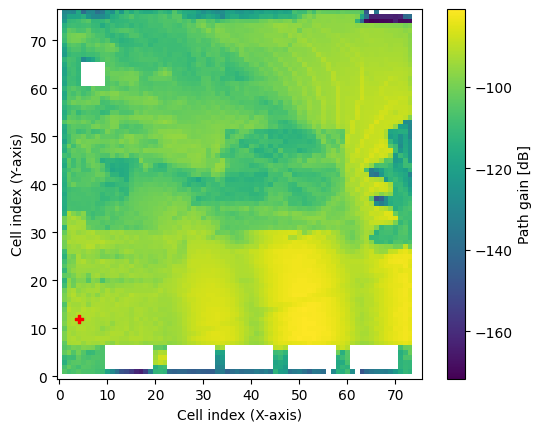

In [103]:
cm.show(tx=0); # If multiple transmitters exist, tx selects for which transmitter the cm is shown